In [1]:
import scanpy as sc, anndata as ad, numpy as np, pandas as pd
from scipy import sparse
from anndata import AnnData
import warnings
import socket
from matplotlib import pylab
import sys
import yaml
import os
import matplotlib.pyplot as plt
import scvelo as scv
from pybiomart import Server
from tqdm.notebook import tqdm
import itertools
import plotly.express as px
import math

import random

warnings.filterwarnings('ignore')


# In[2]:


get_ipython().run_line_magic('matplotlib', 'inline')


# In[3]:


sc.settings.verbosity = 3         # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=50, facecolor='white')
pylab.rcParams['figure.figsize'] = (4, 4)

scanpy==1.8.1 anndata==0.7.6 umap==0.4.6 numpy==1.20.2 scipy==1.6.3 pandas==1.2.4 scikit-learn==0.24.2 statsmodels==0.13.1 python-igraph==0.9.8 louvain==0.7.1 pynndescent==0.5.5


### Configure paths

In [2]:
sc.settings.verbosity = 3         # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=50, facecolor='white')
pylab.rcParams['figure.figsize'] = (10, 10)


scanpy==1.8.1 anndata==0.7.6 umap==0.4.6 numpy==1.20.2 scipy==1.6.3 pandas==1.2.4 scikit-learn==0.24.2 statsmodels==0.13.1 python-igraph==0.9.8 louvain==0.7.1 pynndescent==0.5.5


In [3]:
hostRoot = "-".join(socket.gethostname().split('-')[0:2])

with open(os.path.expanduser('~')+"/paths_config.yaml", 'r') as f:
    paths = yaml.load(f, Loader=yaml.FullLoader)

#indir=paths["paths"]["indir"][hostRoot]
outdir="./outdir"
FinaLeaf = "/Cycling"
externalDataNowaraw = "./data/badhuri_atlas.h5ad"

#projectBaseDir=paths["paths"]["projectBaseDir"][hostRoot]
adataPath = outdir+"/BadhuriCurated.h5ad"
badhuriMarkers = ["FOS","DDIT3","CEBPD","HOPX","SUB1","HES4","NR2F1","NFIA","FOXO3","FOXP1","NFIB","TCF4","NFIX","HMGB2","SOX11","ZBTB18","BCL11A","ZNF462","ZIC2"]
Dividing_cluster_label_aggr = ["dividing"]
Dividing_geschwindIngested = ["PgS","PgG2M"]
Radial_cluster_label_aggr = ["radial"]
Radial_geschwindIngested = ["vRG","oRG"]
individualsToRemove = ["GW20"]

# Re analyses of prebulk

In [4]:
adata = sc.read_h5ad(adataPath)


In [5]:
adata.obs["phase"] != "G1"

gw19_2_PFC_AAACCCAGTACAAACA    False
gw19_2_PFC_AAACCCAGTCTTGCGG    False
gw19_2_PFC_AAACGAATCGTTATCT    False
gw19_2_PFC_AAACGAATCTTCCGTG    False
gw19_2_PFC_AAACGCTCACTGTTCC    False
                               ...  
GW16_V1_TGGAGAGGTTGGTAGG       False
GW16_V1_TGTACAGCATGGAACG        True
GW16_V1_TGTCCCAGTTGCGTAT        True
GW16_V1_TTCAATCGTTTCGATG        True
GW16_V1_TTGCGTCCATGAGGGT        True
Name: phase, Length: 383672, dtype: bool

In [6]:
#Select dividing
adata = adata[(adata.obs["GeschIngestedAnno"].isin(Dividing_geschwindIngested)) & (adata.obs["cluster_label_aggr"].isin(Dividing_cluster_label_aggr)) & (adata.obs["phase"] != "G1")]

adata = adata[~adata.obs["individual"].isin(individualsToRemove)]
adata

View of AnnData object with n_obs × n_vars = 27077 × 1201
    obs: 'development_stage_ontology_term_id', 'individual', 'brain_region', 'cortical_area', 'lamina', 'cluster_label', 'ngene', 'numi', 'percent_mito', 'percent_ribo', 'ncount_rna', 'nfeature_rna', 'tissue_ontology_term_id', 'assay_ontology_term_id', 'disease_ontology_term_id', 'cell_type_ontology_term_id', 'ethnicity_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'sex_ontology_term_id', 'cell_type', 'assay', 'disease', 'organism', 'sex', 'tissue', 'ethnicity', 'development_stage', 'S_score', 'G2M_score', 'phase', 'cluster_label_aggr', 'batch', 'cluster_label_area_age', 'cluster_label_area', 'GeschIngestedAnno', 'cluster_label_area_layers'
    var: 'feature_name', 'feature_reference', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'GeschIngestedAnno_colors', 'X_normalization', 'batch_colors', 'cell_type_colors', 'cluster_label_aggr_colors', 'cluster_label_area_colors',

In [7]:
adata.obs[["GeschIngestedAnno","cluster_label_aggr"]]

,GeschIngestedAnno,cluster_label_aggr
gw19_2_PFC_AAAGGTACAATCGTCA,PgG2M,dividing
gw19_2_PFC_AAAGTCCAGCTACGTT,PgG2M,dividing
gw19_2_PFC_AACAAGACATCGGTTA,PgG2M,dividing
gw19_2_PFC_AACCACATCAGGGTAG,PgS,dividing
gw19_2_PFC_AACCTTTGTGATAGTA,PgS,dividing
...,...,...
GW16_V1_ATGTCTTCACCCAATA,PgG2M,dividing
GW16_V1_CCGCAAGTCTAGACCA,PgG2M,dividing
GW16_V1_CCTCACACAAGTTGGG,PgG2M,dividing
GW16_V1_CGAGAAGGTCGTCAGC,PgG2M,dividing


# Re process

In [8]:
adata = adata.raw.to_adata()
adata.raw = adata.copy()
sc.pp.scale(adata, max_value=20)
sc.tl.pca(adata, svd_solver='arpack')
import scanpy.external as sce
sce.pp.harmony_integrate(adata,key="batch", max_iter_harmony = 20, adjusted_basis = "pca_harmony")


... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:04)


2023-04-27 09:20:48,943 - harmonypy - INFO - Iteration 1 of 20
2023-04-27 09:20:55,846 - harmonypy - INFO - Iteration 2 of 20
2023-04-27 09:21:03,500 - harmonypy - INFO - Iteration 3 of 20
2023-04-27 09:21:09,401 - harmonypy - INFO - Converged after 3 iterations


In [9]:
sc.pp.neighbors(adata, n_neighbors= 100, n_pcs=50, use_rep="pca_harmony")
sc.tl.umap(adata)
sc.tl.diffmap(adata)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:37)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:29)
computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.97050935 0.96633464 0.95427996 0.9439335  0.93188715
     0.9311735  0.92472255 0.9099916  0.9057133  0.8947436  0.8882704
     0.8867082  0.8807899  0.87509465]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns) (0:00:02)


# Diffmap

In [10]:
sc.pl.diffmap(adata, size = 100,color=["batch","cluster_label_aggr","GeschIngestedAnno","individual","TOP2A"], components=["1,3","1,2","3,4","2,3"], ncols=2)

# Leiden

In [11]:
sc.tl.leiden(adata, resolution=.5, key_added="leiden")

running Leiden clustering
    finished: found 10 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:25)


# UMAP

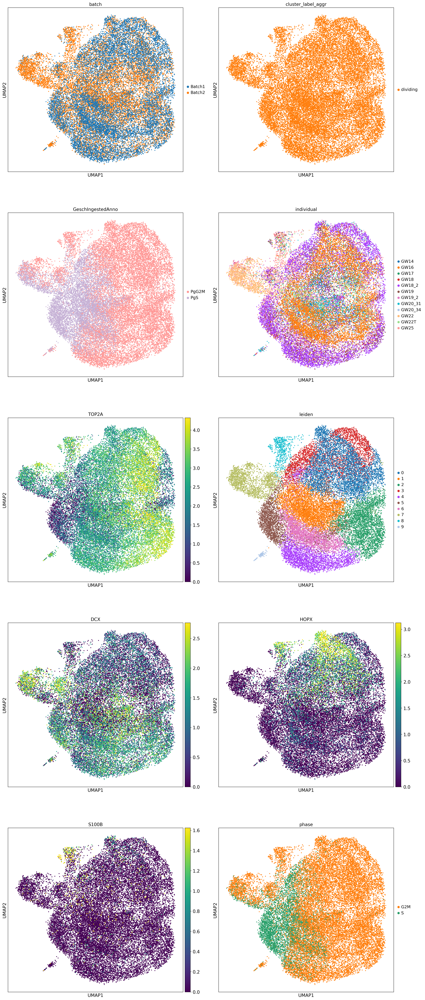

In [12]:
sc.pl.umap(adata, size = 30,color=["batch","cluster_label_aggr","GeschIngestedAnno","individual","TOP2A","leiden","DCX","HOPX","S100B","phase"],  ncols=2, vmin="p1",vmax="p99")

# DE

In [13]:
sc.tl.rank_genes_groups(adata, groupby="leiden")

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:04)


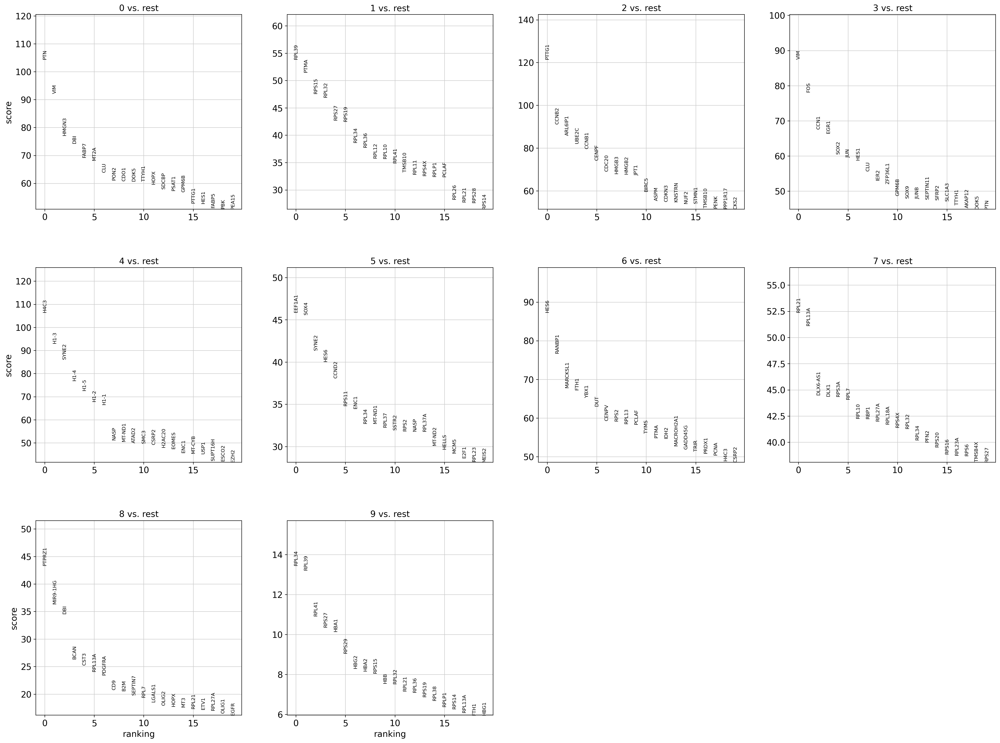

In [14]:
pylab.rcParams['figure.figsize'] = (7, 7)

sc.pl.rank_genes_groups(adata, sharey=False)
pylab.rcParams['figure.figsize'] = (9, 9)


### Plot per individual

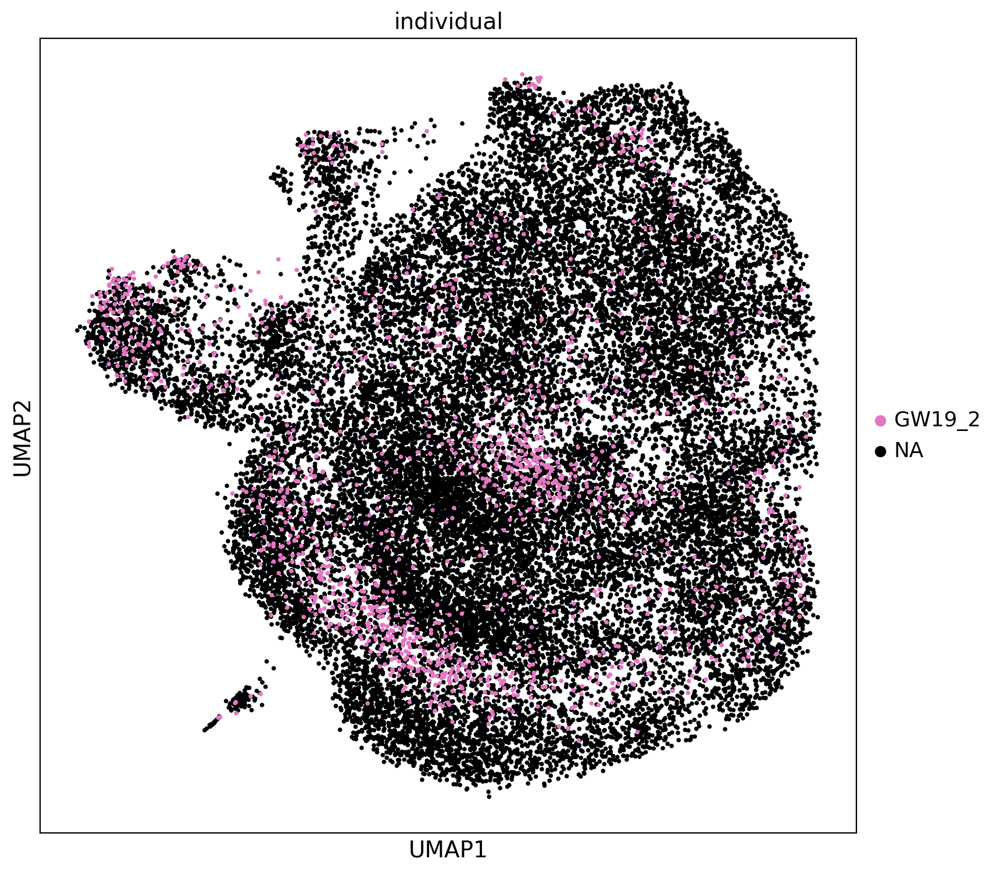

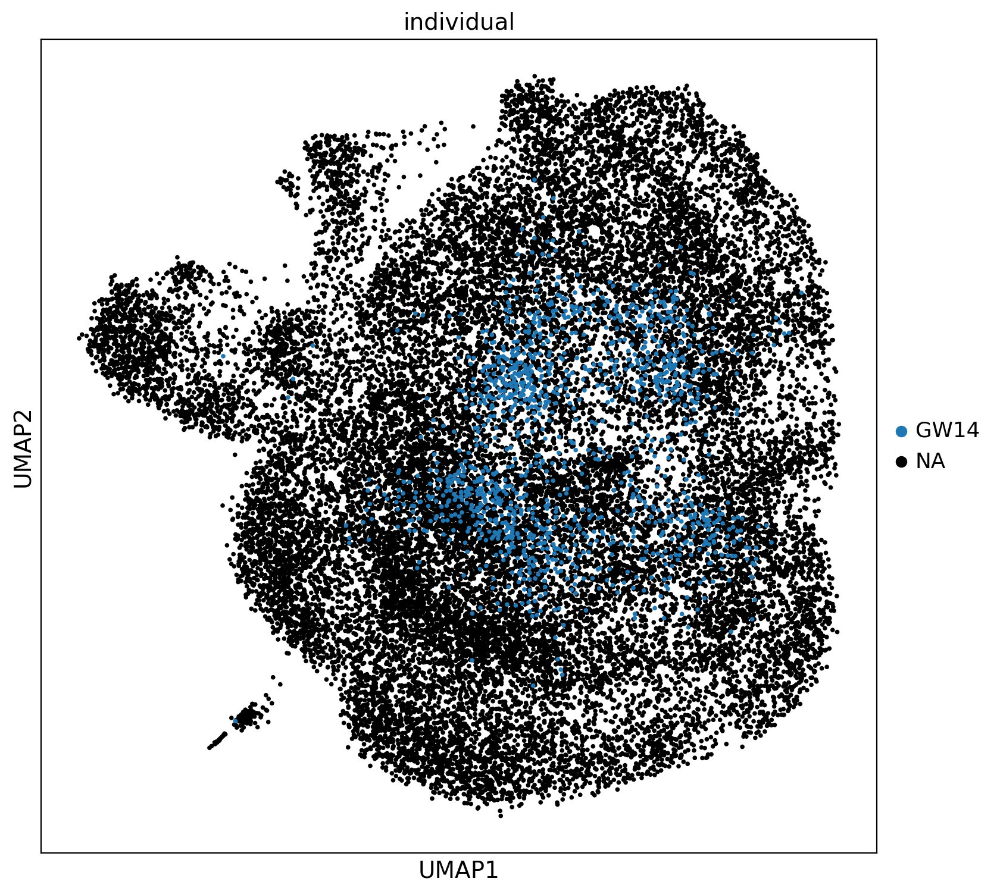

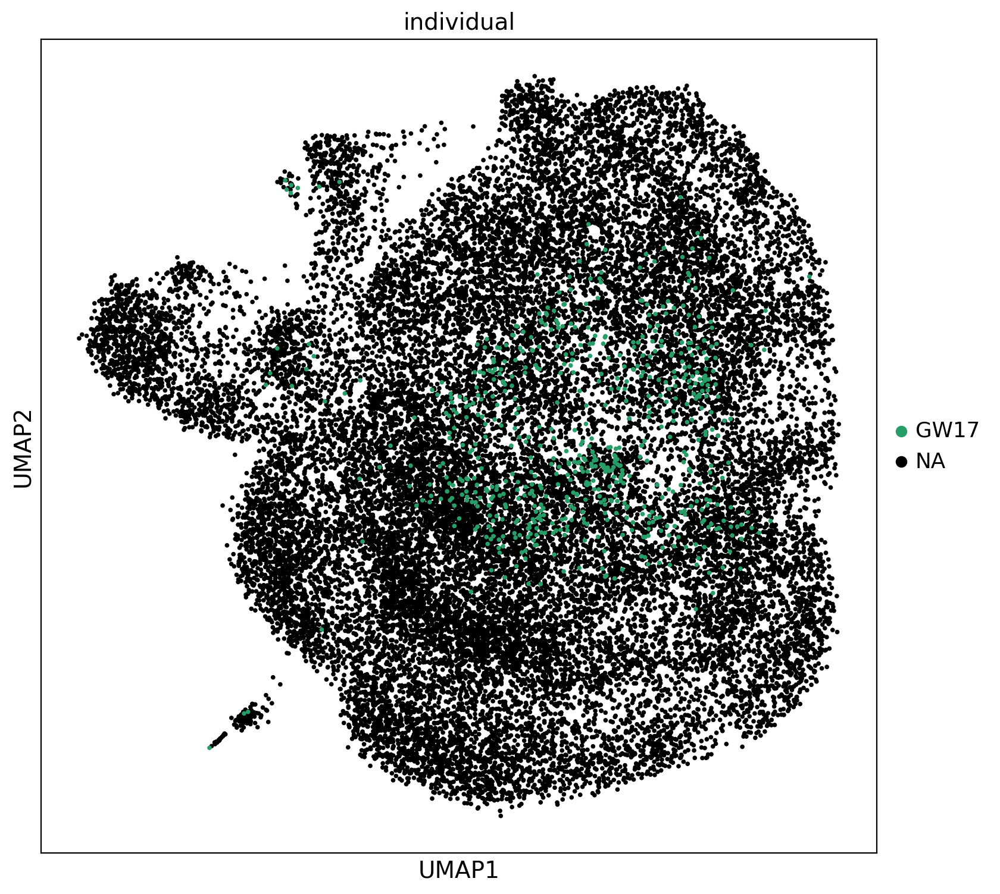

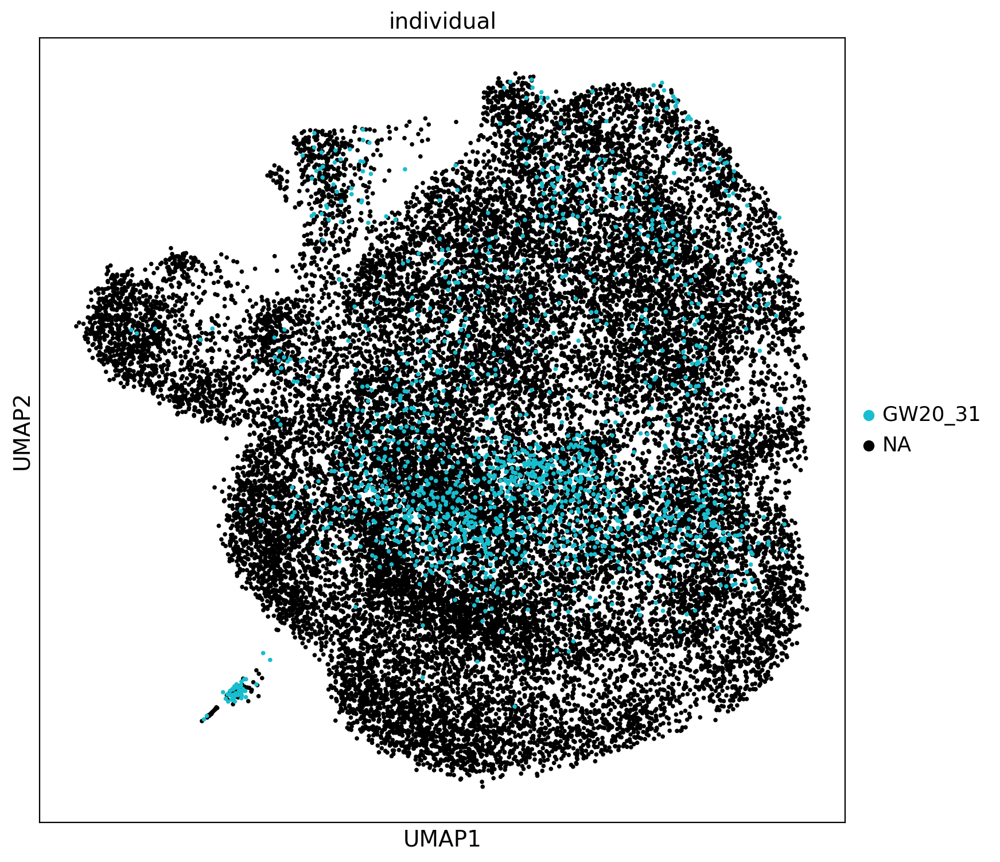

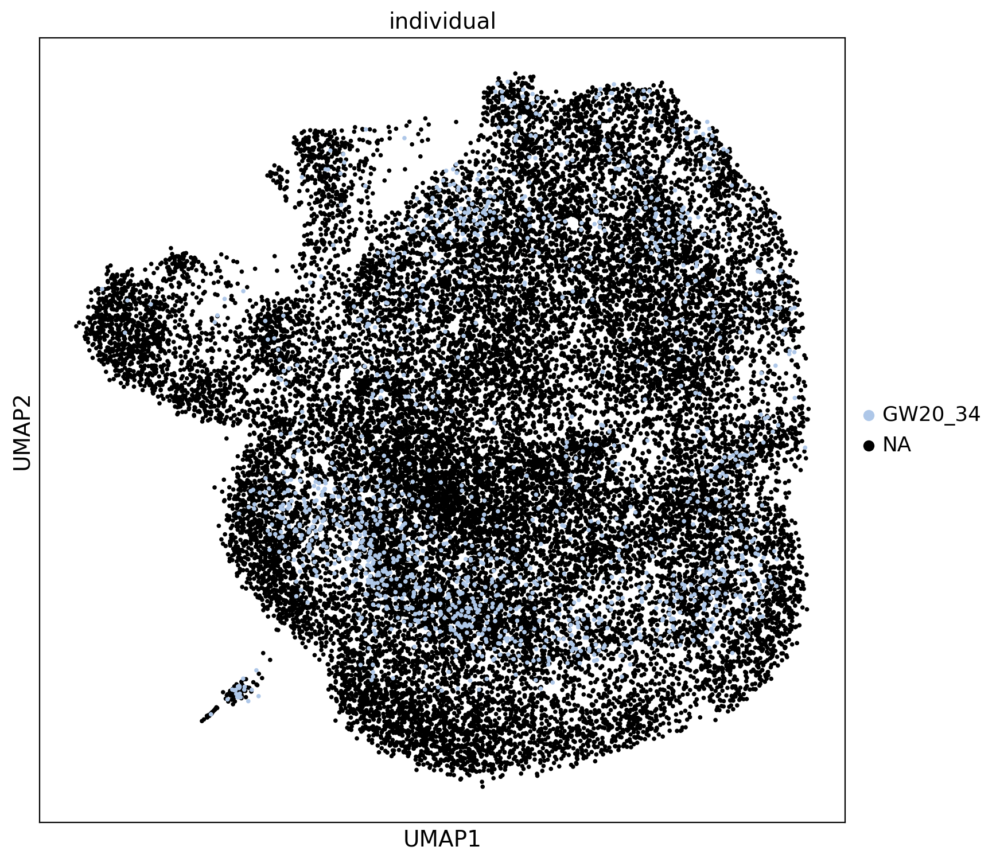

...

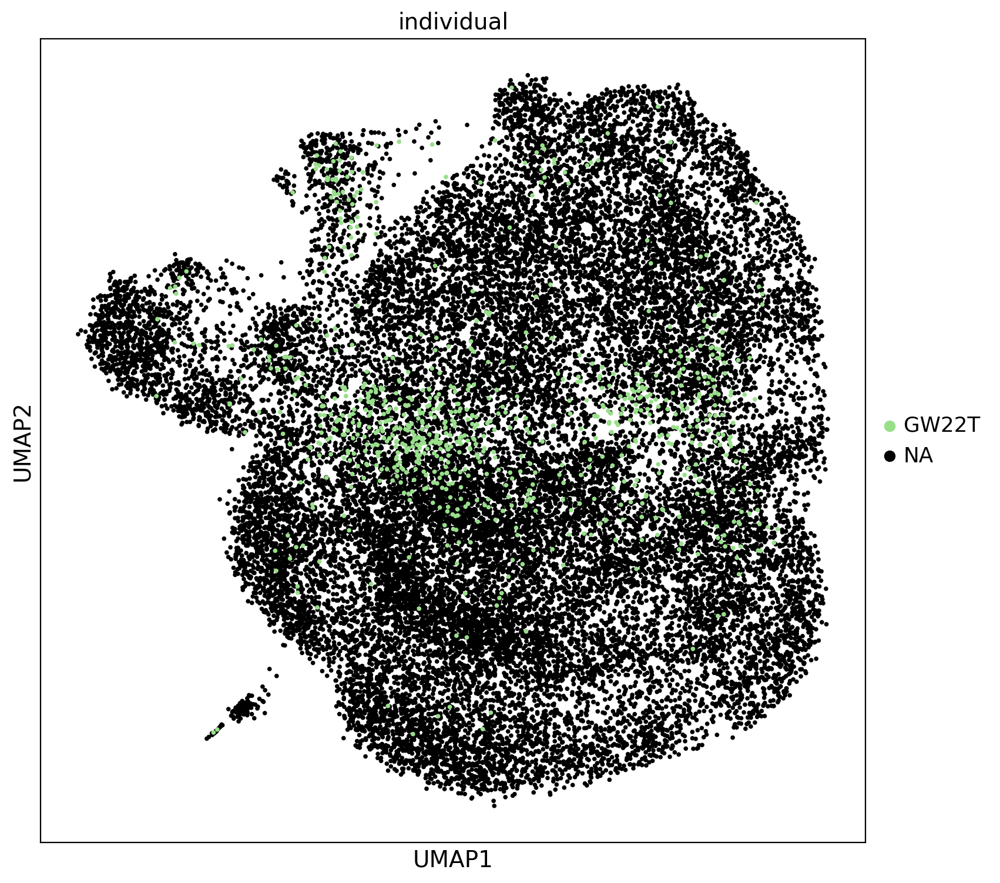

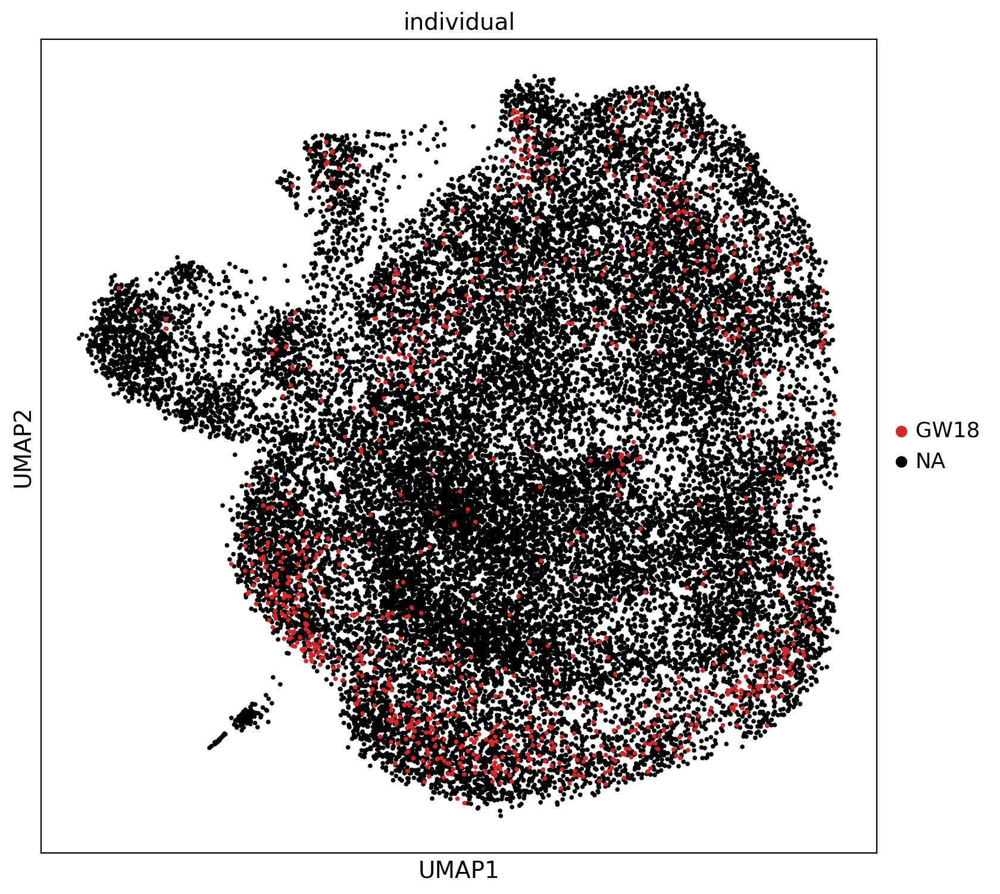

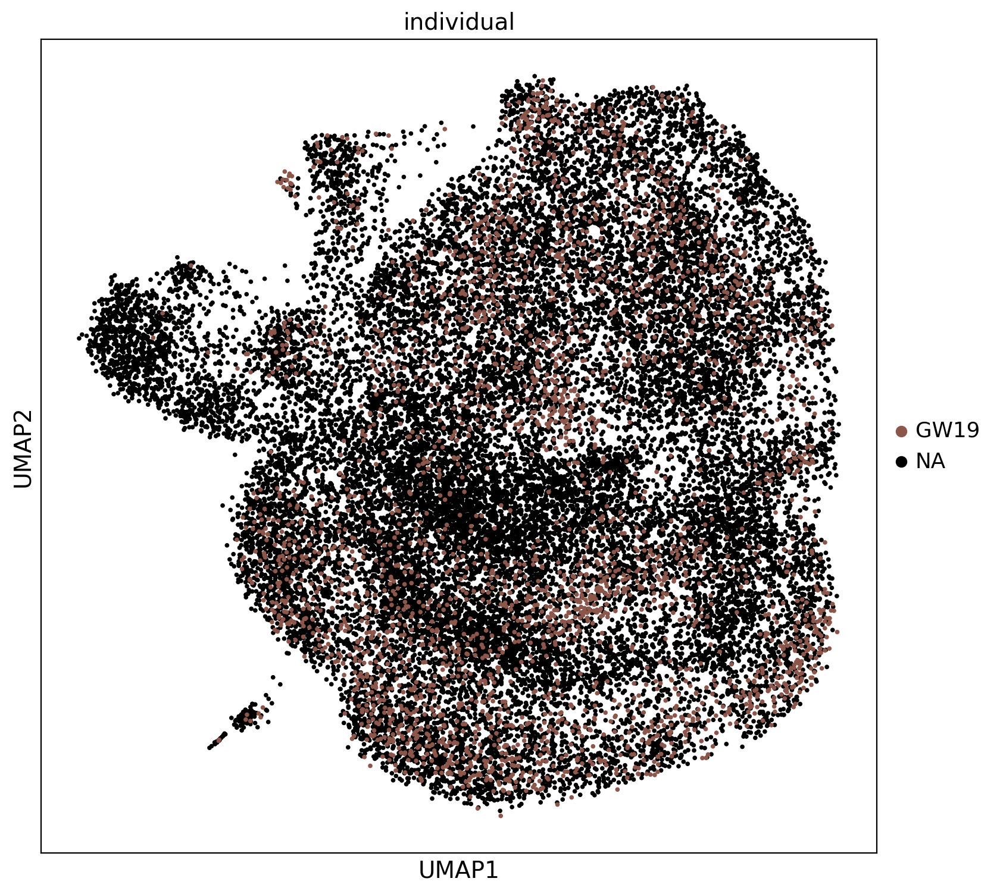

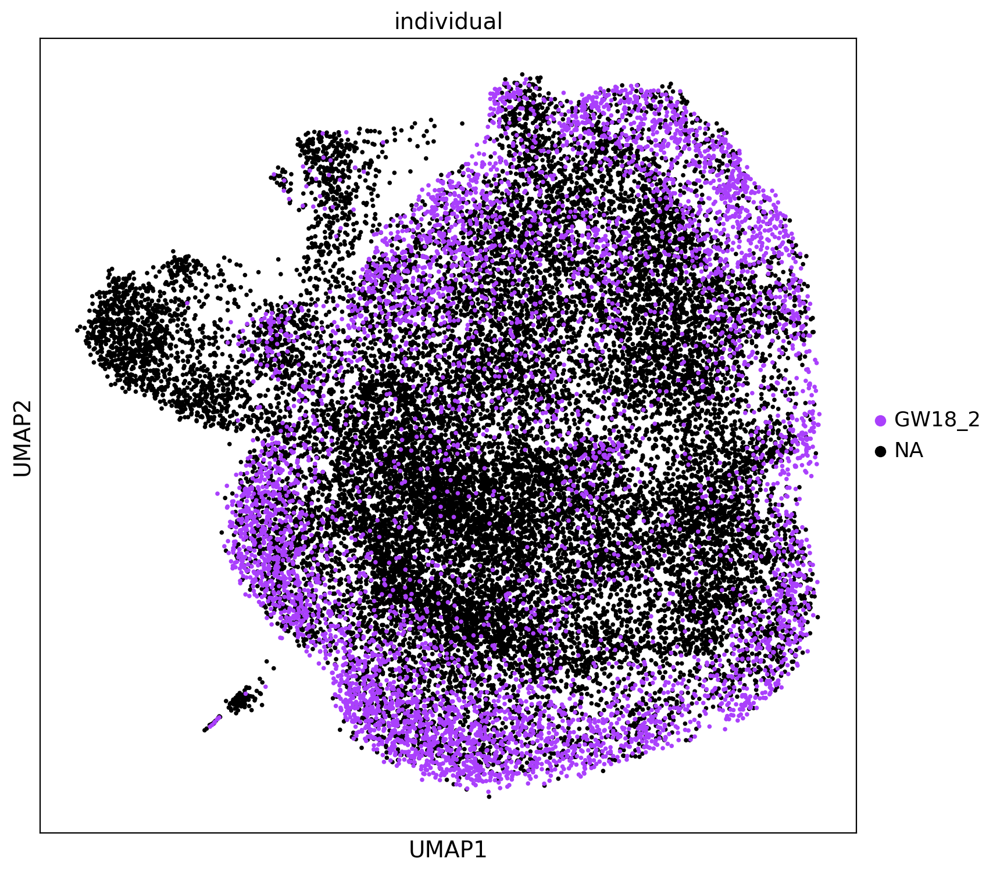

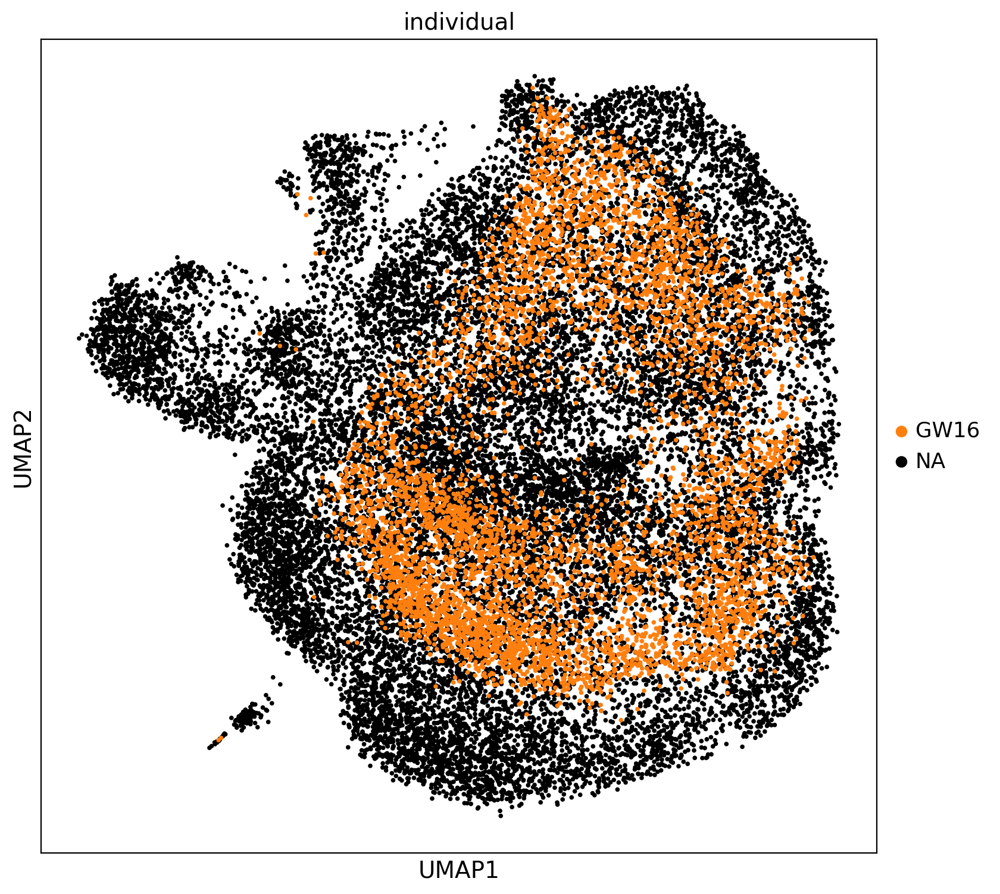

In [15]:
for ID in adata.obs.individual.unique():
    sc.pl.umap(adata,color="individual", groups=[ID], size = 30, na_color="black")


# Remove cluster 8 (strong expression of s100b) and 7 private of just one genotype 

In [16]:
adata = adata[~adata.obs.leiden.isin(["8","7"])]

In [17]:
if not os.path.isdir(outdir+FinaLeaf):
    os.mkdir(outdir+FinaLeaf)

In [18]:
pd.Series(adata.obs_names).to_csv(outdir+FinaLeaf+"/Badhuri_cycling_prebulk.Curated.barcodelist.tsv", sep="\t")